In [ ]:
from google.colab import drive

import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

import csv
from sklearn.preprocessing import MinMaxScaler
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix, matthews_corrcoef, cohen_kappa_score
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier


drive.mount('/content/drive')

# 1 Author

**Student Name**: Alex Santonastaso  
**Student ID**:  210991068



# 2 Problem formulation

This problem will consist of a multiclass (3 classes) classification task using machine learning algorithms that will learn how to assign a class label to examples from the MLEnd Hums and Whistles Dataset. More precisely the algorithm will take as input 3 features representing a Potter, StarWars or Panther audio file and predict its label.

# 3 Machine Learning pipeline

The following paragraph describes the machine learning pipeline:


### **Data loading**

**Input:** the audio data in .wav format will be retrieved from MLEnd Hums and Whistles Potter, StarWars and Panther dataset, composed of 417 Potter, 417 StarWars samples, 418 Panther samples, totalling 1252 files. One random panther sample will be deleted in order to perfectly balance the classes.

### **Transformation:**

***Feature extraction*** is used to transform raw data into numerical features that can be processed while preserving the information in the original data set.


***Linear tranformation***: of the extracted feature data using MinMaxScaler.


### **Models:**

Support Vector Machine, Logistic Regression, Naive Bayes classifier, MLP classifier, XGBoost classifier models are implemented for the resolution of this problem.


### **Model Evaluation:**

Model validation performance evaluated using accuracy, confusion matrix MCC score and Kappa score.


# 4 Transformation stage

As part of the transformation stage, the following was undertaken:
    
### **Feature extraction**:  

***Input: raw .wav data for Potter, Starwars, Panther (417 files for each label):***
    
The original data was in .wav format, each file consisting of hundred thousands samples. In order to reduce dimensionality features were extracted using signal processing functions obtained from the Librosa library. The following features were extracted:
    
**Spectral Features**

1. Mel-frequency cepstral coefficients (MFCCs)(librosa.feature.mfcc)
2. Spectral bandwidth (librosa.feature.spectral_bandwidth)
    
**Beat and tempo Feature**

1. Tempo Estimation (librosa.beat.tempo)

    
***Output: The features extracted resulted in a 3-dimensional vector of features***



### **Feature scaling**:

***Input: Numerical Features:***

The features extracted were normalised using a normalisation technique MinMaxScaler [0,1]. The reason for this scaling is because the data isn't normally distributed. This approach was used to preserve the shape of the data.

***Output: 3 Dimensional Normalised Feature Array***



# 5 Modelling

The following Machine Learning models were implemented:
1.  Support Vector Machine (SVM).
2.  Logistic Regression.
3.  Gaussian Naive Bayes.
4.  Multi Layer Perceptron (MLP).
5.  XGBoost Classifier.

# 6 Methodology

**Data Split:** : The data is split into training data consisting of 70% of instances and validation data consisting of 30% of instances.

**Predictors and Labels**: An array of normalized features were used as predictors X and 'Potter', 'StarWars', 'Panther' were used as y labels.

**Model Training:** The models were trained on the training data consisting of 70% of the dataset. A Support Vector Machine (SVM) classification algorithm, Logistic Regression classification and Naive Bayes were used.

**Model Peformance:** After each model was fitted to the 70% training data split, it was validated on the remaining 30% to assess performance. Each models performance was compared using accuracy, confusion matrix, MCC score, Kappa score.


# 7 Dataset

The dataset used for this problem is a subset of the MLEnd Hums and Whistles dataset consisting of only hum and whistles of Potter, StarWars and Panther songs.
\
First, let's define a function that will allow us to download a file into a chosen location.

In [ ]:
def download_url(url, save_path):
    with urllib.request.urlopen(url) as dl_file:
        with open(save_path, 'wb') as out_file:
            out_file.write(dl_file.read())

The next step is to download the files 'Potter_1.zip', 'Potter_2.zip', 'StarWars_1.zip', 'StarWars_2.zip', 'Panther_1.zip', 'Panther_2.zip' into the already existing folder MyDrive/Data/MLEndHW in my Google Drive.

In [ ]:
#Potter1
url  = "https://collect.qmul.ac.uk/down?t=6P0I5CAE7JPPKNDU/4P729FD6DFNO8IT4NNFR458"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Potter1.zip'
download_url(url, save_path)

In [ ]:
#Potter2
url  = "https://collect.qmul.ac.uk/down?t=452THMOKUOST11V4/4L7IBFL5AJ3AMR45JVV9AC0"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Potter2.zip'
download_url(url, save_path)

In [ ]:
#StarWars1
url  = "https://collect.qmul.ac.uk/down?t=4HOGB7IH67J8QGL3/5D5TJMIP30DFVC69AQU5ETO"
save_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars1.zip'
download_url(url, save_path)

In [ ]:
#StarWars2
url  = "https://collect.qmul.ac.uk/down?t=4LUHB7IH67J8QGL3/6T5IF3SK8KQTL7FRD2113DO"
save_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars2.zip'
download_url(url, save_path)

In [ ]:
#Panther1
url  = "https://collect.qmul.ac.uk/down?t=45O07QG5SKLC2TKN/6PEIJD5VEBGBEUSOHNLOA9G"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Panther1.zip'
download_url(url, save_path)

In [ ]:
#Panther2
url  = "https://collect.qmul.ac.uk/down?t=556JF9IP9676AAIB/450D7KAI0S5U15VGE2A7MKO"
save_path = '/content/drive/MyDrive/Data/MLEndHW/Panther2.zip'
download_url(url, save_path)

After downloading is complete we can run the following cell to check that the MLEndHW contains the files 'Potter1.zip', 'Potter2.zip', 'StarWars1.zip', 'StarWars2.zip', 'Panther1.zip', 'Panther2.zip'.

In [ ]:
path = '/content/drive/MyDrive/Data/MLEndHW'
os.listdir(path)

['Potter',
 'StarWars',
 'Potter1.zip',
 'Potter2.zip',
 'StarWars1.zip',
 'StarWars2.zip',
 'X.csv',
 'y.csv',
 'Panther1.zip',
 'Panther',
 'Panther2.zip',
 'X_advanced.csv',
 'y_advanced.csv',
 'y_advanced.gsheet']

Let's unzip the data we just downloaded: Potter Hums and Whistles into the 'Potter' folder; StarWars Hums and Whistles into the 'StarWars' folder, Panther Hums and Whistles into the 'Panther' folder. Then we can check how many files we have.

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Potter/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Potter1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Potter/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Potter2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/StarWars/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/StarWars/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/StarWars2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Panther/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Panther1.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Panther/'
zip_path = '/content/drive/MyDrive/Data/MLEndHW/Panther2.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
potterPath = '/content/drive/MyDrive/Data/MLEndHW/Potter/*'
potterFiles = glob.glob(potterPath)
print('There are ' + str(len(potterFiles)) + ' Potter samples.')

starWarsPath = '/content/drive/MyDrive/Data/MLEndHW/StarWars/*'
starWarsFiles = glob.glob(starWarsPath)
print('There are ' + str(len(starWarsFiles)) + ' StarWars samples.')

pantherPath = '/content/drive/MyDrive/Data/MLEndHW/Panther/*'
pantherFiles = glob.glob(pantherPath)
print('There are ' + str(len(pantherFiles)) + ' Panther samples.')

files = potterFiles+starWarsFiles+pantherFiles
print('There are ' + str(len(files)) + ' total samples.')

There are 417 Potter samples.
There are 417 StarWars samples.
There are 418 Panther samples.
There are 1251 total samples.


As we can see from the previous cell output, there are 417 Potter samples, 417 StarWars samples, 418 Panther samples. In order to have the three classes perfectly balanced I will delete a random Panther sample so there will be 417.

In [ ]:
#i = random.randint(1, 417)
#os.remove(pantherFiles[i])
pantherPath = '/content/drive/MyDrive/Data/MLEndHW/Panther/*'
pantherFiles = glob.glob(pantherPath)
print('There are ' + str(len(pantherFiles)) + ' Panther samples.')

files = potterFiles+starWarsFiles+pantherFiles
print('There are ' + str(len(files)) + ' total samples.')

There are 417 Panther samples.
There are 1251 total samples.


Let's listen to some random audio files:

In [ ]:
for _ in range(5):
  n = np.random.randint(834)
  display(ipd.Audio(files[n]))

Let's have a look at the name of the 834 audio file:

In [ ]:
for file in files:
  print(file.split('/')[-1])

S1_hum_2_Potter.wav
S1_whistle_2_Potter.wav
S2_hum_2_Potter.wav
S3_hum_1_Potter.wav
S2_whistle_2_Potter.wav
S3_hum_2_Potter.wav
S4_hum_1_Potter.wav
S4_hum_2_Potter.wav
S5_hum_1_Potter.wav
S6_hum_2_Potter.wav
S5_hum_2_Potter.wav
S6_whistle_2_Potter.wav
S7_hum_1_Potter.wav
S7_hum_2_Potter.wav
S8_hum_1_[Potter].wav
S8_hum_4_[Potter].wav
S9_hum_1_Potter.wav
S10_hum_1_Potter .wav
S9_hum_2_Potter.wav
S10_hum_2_Potter .wav
S12_hum_2_Potter .wav
S12_hum_4_Potter .wav
S13_hum_1_Potter.wav
S15_hum_2_Potter.wav
S13_hum_2_Potter.wav
S15_whistle_2_Potter.wav
S16_hum_2_Potter.wav
S16_whistle_2_Potter.wav
S17_hum_1_Potter.wav
S17_hum_2_Potter.wav
S19_hum_1_Potter.wav
S18_Hum_2_Potter.wav
S18_Whistle_2_Potter.wav
S20_hum_1_Potter.wav
S19_hum_2_Potter.wav
S20_hum_2_Potter.wav
S21_hum_1_Potter.wav
S21_hum_2_Potter.wav
S22_hum_1_Potter.wav
S22_hum_2_Potter.wav
S23_hum_1_Potter.wav
S24_hum_2_Potter.wav
S23_hum_2_Potter.wav
S24_whistle_2_Potter.wav
S25_hum_1_Potter.wav
S25_hum_2_Potter.wav
S26_hum_1_Potter

As we can see, the name of each file follows the naming convention [Participant ID][type of recording][interpretation number][song]. However we can notice just by skimming through the file list that some naming inconsistencies are present: for example 'harry potter' or '[Potter]' in the 'song' field, instead of 'Potter'. We can parse each file name and extract this information. Let's do it for the first one:




In [ ]:
print('The full path to the first audio file is: ', files[0])
print('\n')
print('The name of the first audio file is: ', files[0].split('/')[-1])
print('    The participand ID is: ', files[0].split('/')[-1].split('_')[0])
print('    The type of interpretation is: ', files[0].split('/')[-1].split('_')[1])
print('    The interpretation number is: ', files[0].split('/')[-1].split('_')[2])
print('    The song is: ', files[0].split('/')[-1].split('_')[3])

The full path to the first audio file is:  /content/drive/MyDrive/Data/MLEndHW/Potter/S1_hum_2_Potter.wav


The name of the first audio file is:  S1_hum_2_Potter.wav
    The participand ID is:  S1
    The type of interpretation is:  hum
    The interpretation number is:  2
    The song is:  Potter.wav


As what we care for this classification problem is only the file label (Potter,StarWars, Panther), we will run this three regex function that will return three lists containing all the inconsistent Potter, StarWars, Panther file names.

In [ ]:
inconsistentPotterFiles = []
print(f' The following inconsitent file names have been indentifed:\n')
for file in potterFiles:
    match = re.search("_Potter.wav", file)
    if match:
        pass
    else:
         inconsistentPotterFiles.append(file.split('Potter/',1)[1:])
         print(file.split('Potter/',1)[1:])
len(inconsistentPotterFiles)

 The following inconsitent file names have been indentifed:

['S8_hum_1_[Potter].wav']
['S8_hum_4_[Potter].wav']
['S10_hum_1_Potter .wav']
['S10_hum_2_Potter .wav']
['S12_hum_2_Potter .wav']
['S12_hum_4_Potter .wav']
['S29_whistle_2_potter.wav']
['S35_hum_1_[Potter].wav']
['S35_hum_4_[Potter].wav']
['S37_hum_1_[Potter].wav']
['S37_whistle_1_[Potter].wav']
['S38_hum_3_Potterwav.wav']
['S40_whistle_2_potter.wav']
['S40_hum_2_potter.wav']
['S47_hum_1_potter.wav']
['S47_hum_2_potter.wav']
['S49_hum_1_[potter].wav']
['S49_hum_4_[potter].wav']
['S55_harrypotter_whistle_1.wav']
['S55_harrypotter_hum_2.wav']
['S60_whistle_1_[Potter].wav']
['S60_hum_1_[Potter].wav']
['S61_hum_1_[Potter].wav']
['S61_whistle_1_[Potter].wav']
['S63_hum_1_[Potter].wav']
['S63_hum_4_[Potter].wav']
['S79_hum_1_[Potter].wav']
['S79_hum_4_[Potter].wav']
['S82_hum_1_[Potter].wav']
['S82_hum_4_[Potter].wav']
['S88_whistle_1_[potter].wav']
['S88_hum_1_[potter].wav']
['S95_Hum 2 Potter.wav']
['S95_Whistle 2 Potter.wav']
['

71

In [ ]:
inconsistentStarWarsFiles = []
print(f' The following inconsitent StarWars file names have been indentifed:\n')
for file in starWarsFiles:
    match = re.search("_StarWars.wav", file)
    if match:
        pass
    else:
         inconsistentStarWarsFiles.append(file.split('StarWars/',1)[1:])
         print(file.split('StarWars/',1)[1:])
len(inconsistentStarWarsFiles)

 The following inconsitent StarWars file names have been indentifed:

['S5_hum_3_Starwars.wav']
['S5_hum_4_Starwars.wav']
['S6_whisle_1_starwar.wav']
['S6_whisle_2_starwar.wav']
['S8_hum_3_[StarWars].wav']
['S8_hum_4_[StarWars].wav']
['S18_Whistle_2_Starwars.wav']
['S18_Hum_2_Starwars.wav']
['S24_whistle_2_Starwars.wav']
['S35_hum_3_[StarWars].wav']
['S35_hum_4_[StarWars].wav']
['S37_hum_1_[StarWars].wav']
['S37_hum_2_[StarWars].wav']
['S40_hum_2_starwars.wav']
['S40_whistle_2_starwars.wav']
['S42_Hum2_StarWar.wav']
['S42_Hum3.StarWar.wav']
['S47_hum_3_starwars.wav']
['S47_hum_4_starwars.wav']
['S48_Hum_2_Starwars.wav']
['S48_Whistle_2_Starwars.wav']
['S49_hum_2_[ Star Wars ].wav']
['S49_hum_3_[ Star Wars ].wav']
['S55_starwars_hum_1.wav']
['S55_starwars_whistle_2.wav']
['S60_hum_1_[StarWars].wav']
['S60_hum_2_[StarWars].wav']
['S61_hum_1_[StarWars].wav']
['S61_hum_2_[StatWars].wav']
['S63_hum_3_[Starwars].wav']
['S63_hum_4_[Starwars].wav']
['S76_whistle_2_Starwars.wav']
['S79_hum_3_[S

94

In [ ]:
inconsistentPantherFiles = []
print(f' The following inconsitent Panther file names have been indentifed:\n')
for file in pantherFiles:
    match = re.search("_Panther.wav", file)
    if match:
        pass
    else:
         inconsistentPantherFiles.append(file.split('Panther/',1)[1:])
         print(file.split('Panther/',1)[1:])
len(inconsistentPantherFiles)

 The following inconsitent Panther file names have been indentifed:

['S5_hum_1_PinkPanther.wav']
['S5_hum_4_PinkPanther.wav']
['S8_hum_1_[Panther].wav']
['S8_hum_2_[Panther].wav']
['S32_whistle_1_panther.wav']
['S35_hum_1_ [Panther].wav']
['S35_hum_4_[Panther].wav']
['S37_hum_1_[Panther].wav']
['S37_hum_2_[Panther].wav']
['S40_hum_2_panther.wav']
['S40_whistle_1_panther.wav']
['S42_Hum2_Pink Panther.wav.Wav']
['S42_Hum3_Pink Panther.wav.wav']
['S45_hum_2_panther.wav']
['S47_hum_1_pinkpanther.wav']
['S47_whistle_1_pinkpanther.wav']
['S49_hum_1_[  Panther ].wav']
['S49_hum_3_[ Panther ].wav']
['S55_pinkpanther_hum_2.wav']
['S55_pinkpanther_whistle_2.wav']
['S56_whistle_1_panther.wav']
['S60_hum_1_[Panther].wav']
['S60_hum_2_[Panther].wav']
['S61_hum_1_[Panther].wav']
['S61_hum_2_[Panther].wav']
['S63_hum_1_[Panther].wav']
['S63_hum_2_[Panther].wav']
['S79_hum_2_[Panther].wav']
['S82_hum_1_[Panther].wav']
['S82_hum_2_[Panther].wav']
['S88_hum_1_[Panther].wav']
['S88_hum_2_[Panther].wav']

67

In [ ]:
inconsistentFiles = inconsistentPotterFiles + inconsistentStarWarsFiles + inconsistentPantherFiles
print('There are ' + str(len(inconsistentFiles)) + ' total samples with inconsistent naming convention.')
print('There are ' + str(len(inconsistentPotterFiles)) + ' Potter samples with inconsistent naming convention.')
print('There are ' + str(len(inconsistentStarWarsFiles)) + ' StarWars samples with inconsistent naming convention.')
print('There are ' + str(len(inconsistentPantherFiles)) + ' Panther samples with inconsistent naming convention.')

There are 232 total samples with inconsistent naming convention.
There are 71 Potter samples with inconsistent naming convention.
There are 94 StarWars samples with inconsistent naming convention.
There are 67 Panther samples with inconsistent naming convention.


We can create a table-like structure using Python lists that collects the information that we can extract from the names of the audio files.
\
In order to avoid errors caused by the files with inconsistent naming convention, we will enter the song name manually: 'Potter' for all the files contained in the potterFiles list, 'StarWars' for all the files contained in the starWarsFiles list, 'Panther' for all the files contained in the pantherFiles list.
\
For each of these filelists, we will check with regex function 'search' if the words 'hum' or 'Hum' is contained in every file. If it is, the interpretation type 'Hum' will be added to the file in the list, otherwise 'Whistle' will be appended to the file.

In [ ]:
MLENDHW_table = []

for file in potterFiles:
  match1 = re.search("hum", file)
  match3 = re.search("Hum", file)
  fileName = file.split('/')[-1]
  interpreterID = ((file.split('/')[7]).split('_')[0])
  song = 'Potter'
  if match1 or match3:
    MLENDHW_table.append([fileName,interpreterID,'Hum', song])
  else:
    MLENDHW_table.append([fileName,interpreterID,'Whistle', song])

for file in starWarsFiles:
  match1 = re.search("hum", file)
  match3 = re.search("Hum", file)
  fileName = file.split('/')[-1]
  interpreterID = ((file.split('/')[7]).split('_')[0])
  song = "StarWars"
  if match1 or match3:
    MLENDHW_table.append([fileName,interpreterID,'Hum', song])
  else:
    MLENDHW_table.append([fileName,interpreterID,'Whistle', song])

for file in pantherFiles:
  match1 = re.search("hum", file)
  match3 = re.search("Hum", file)
  fileName = file.split('/')[-1]
  interpreterID = ((file.split('/')[7]).split('_')[0])
  song = "Panther"
  if match1 or match3:
    MLENDHW_table.append([fileName,interpreterID,'Hum', song])
  else:
    MLENDHW_table.append([fileName,interpreterID,'Whistle', song])

MLENDHW_table

[['S1_hum_2_Potter.wav', 'S1', 'Hum', 'Potter'],
 ['S1_whistle_2_Potter.wav', 'S1', 'Whistle', 'Potter'],
 ['S2_hum_2_Potter.wav', 'S2', 'Hum', 'Potter'],
 ['S3_hum_1_Potter.wav', 'S3', 'Hum', 'Potter'],
 ['S2_whistle_2_Potter.wav', 'S2', 'Whistle', 'Potter'],
 ['S3_hum_2_Potter.wav', 'S3', 'Hum', 'Potter'],
 ['S4_hum_1_Potter.wav', 'S4', 'Hum', 'Potter'],
 ['S4_hum_2_Potter.wav', 'S4', 'Hum', 'Potter'],
 ['S5_hum_1_Potter.wav', 'S5', 'Hum', 'Potter'],
 ['S6_hum_2_Potter.wav', 'S6', 'Hum', 'Potter'],
 ['S5_hum_2_Potter.wav', 'S5', 'Hum', 'Potter'],
 ['S6_whistle_2_Potter.wav', 'S6', 'Whistle', 'Potter'],
 ['S7_hum_1_Potter.wav', 'S7', 'Hum', 'Potter'],
 ['S7_hum_2_Potter.wav', 'S7', 'Hum', 'Potter'],
 ['S8_hum_1_[Potter].wav', 'S8', 'Hum', 'Potter'],
 ['S8_hum_4_[Potter].wav', 'S8', 'Hum', 'Potter'],
 ['S9_hum_1_Potter.wav', 'S9', 'Hum', 'Potter'],
 ['S10_hum_1_Potter .wav', 'S10', 'Hum', 'Potter'],
 ['S9_hum_2_Potter.wav', 'S9', 'Hum', 'Potter'],
 ['S10_hum_2_Potter .wav', 'S10', 'Hum

We can load the table into a Pandas DataFrame and use the additional functionalities of Pandas to explore the information extracted from the names of the audio files.

In [ ]:
MLENDHW_df = pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','song']).set_index('file_id')
MLENDHW_df

,participant,interpretation,song
file_id,,,
S1_hum_2_Potter.wav,S1,Hum,Potter
S1_whistle_2_Potter.wav,S1,Whistle,Potter
S2_hum_2_Potter.wav,S2,Hum,Potter
S3_hum_1_Potter.wav,S3,Hum,Potter
S2_whistle_2_Potter.wav,S2,Whistle,Potter
...,...,...,...
S219_hum_4_Panther.wav,S219,Hum,Panther
S221_hum_2_Panther.wav,S221,Hum,Panther
S221_whistle_1_Panther.wav,S221,Whistle,Panther


In [ ]:
MLENDHW_df['song'].value_counts()

Potter      417
StarWars    417
Panther     417
Name: song, dtype: int64

In [ ]:
MLENDHW_df['interpretation'].value_counts()

Hum        901
Whistle    350
Name: interpretation, dtype: int64

In [ ]:
pd.crosstab(MLENDHW_df.song,MLENDHW_df.interpretation)

interpretation,Hum,Whistle
song,,
Panther,303,114
Potter,294,123
StarWars,304,113


# Feature extraction

Audio files are complex data types. Specifically they are discrete signals or time series, consisting of values on a 1D temporal grid. These values are known as samples themselves, which might be a bit confusing, as we have used this term to refer to the items in our dataset. The sampling frequency is the rate at which samples in an audio file are produced. For instance a sampling frequency of 5HZ indicates that 5 produce 5 samples per second, or 1 sample every 0.2 s.

Let's plot one of our Potter audio signals and one of our StarWars audio signals:

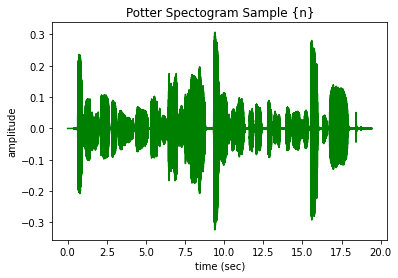

participant           S4
interpretation       Hum
song              Potter
Name: S4_hum_2_Potter.wav, dtype: object



This audio signal has 857627 samples


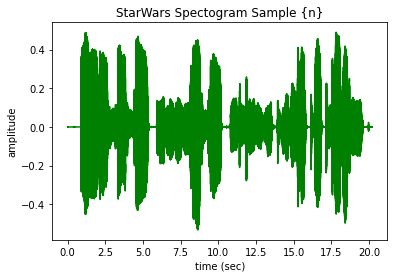

participant             S4
interpretation         Hum
song              StarWars
Name: S4_hum_4_StarWars.wav, dtype: object



This audio signal has 890907 samples


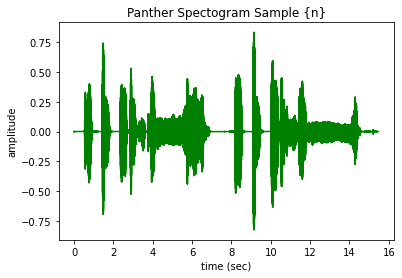

participant            S4
interpretation        Hum
song              Panther
Name: S4_hum_4_Panther.wav, dtype: object



This audio signal has 682267 samples


In [ ]:
n=7
fs = None # Sampling frequency. If None, fs would be 22050
x, sr = librosa.load(potterFiles[n],sr=None)
t = np.arange(len(x))/sr
plt.plot(t,x,c='g')
plt.title('Potter Spectogram Sample {n}')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
print('\n')
display(MLENDHW_df.iloc[n])
print('\n')
print('This audio signal has', len(x), 'samples')
display(ipd.Audio(potterFiles[n]))


fs = None # Sampling frequency. If None, fs would be 22050
x, sr = librosa.load(starWarsFiles[n],sr=None)
t = np.arange(len(x))/sr
plt.plot(t,x,c='g')
plt.title('StarWars Spectogram Sample {n}')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
print('\n')
display(MLENDHW_df.iloc[417+n])
print('\n')
print('This audio signal has', len(x), 'samples')
display(ipd.Audio(starWarsFiles[n]))


fs = None # Sampling frequency. If None, fs would be 22050
x, sr = librosa.load(pantherFiles[n],sr=None)
t = np.arange(len(x))/sr
plt.plot(t,x,c='g')
plt.title('Panther Spectogram Sample {n}')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
print('\n')
display(MLENDHW_df.iloc[834+n])
print('\n')
print('This audio signal has', len(x), 'samples')
display(ipd.Audio(pantherFiles[n]))

If we are using a raw audio signal as the input of a machine learning model, we will be operating in a predictor space consisting of hundreds of thousands of dimensions.

One approach to deal with this huge dimensionality is to extract a few features from our signals and use these features as predictors instead. In this notebook we will use three audio features:

1.   MFCC.
2.   Spectral Bandwith.
3.   Tempo.

In [ ]:
mfcc_list,spec_bw_list,tempo_list=[],[],[]

for i in tqdm(range(len(files))):
  n=i

  y, sr = librosa.load(files[n],sr=None)

  mfcc = librosa.feature.mfcc(y=y, sr=sr)
  mfcc_list.append(np.mean(mfcc))

  spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
  spec_bw_list.append(np.mean(spec_bw))

  tempo = librosa.beat.tempo(y, sr=sr)
  tempo_list.append(tempo)

100%|██████████| 1251/1251 [18:30<00:00,  1.13it/s]


In [ ]:
#create dataframe with features and labels
song=MLENDHW_df['song'].tolist()
features_df=pd.DataFrame(song,columns=['Song'])
features_df['MFCC']=mfcc_list
features_df['Spec_Bandwidth']=spec_bw_list
features_df['Tempo']=tempo_list
features_df['Tempo']=features_df['Tempo'].astype(float)
features_df


,Song,MFCC,Spec_Bandwidth,Tempo
0,Potter,-17.621126,5142.033510,172.265625
1,Potter,-21.501249,5266.609683,120.185320
2,Potter,-21.670408,4765.788845,139.674831
3,Potter,-11.944511,1981.262522,123.046875
4,Potter,-26.031940,5767.036432,120.185320
...,...,...,...,...
1246,Panther,-30.844461,4918.058593,135.999178
1247,Panther,-15.859102,2650.534139,120.185320
1248,Panther,-18.806221,3175.645110,126.048018
1249,Panther,-29.173546,4326.673749,114.843750


Let's consider the problem of identifying the song of one of the audio recordings. The next cell defines a function that takes a number of files and creates a NumPy array containing the 3 audio features used as predictors (X) and a  label (y), that indicates whether the song is Potter, StarWars, Panther .

In [ ]:
X,y =[],[]
for Song, MFCC, Spec_Bandwith, Tempo in zip(features_df['Song'], features_df['MFCC'], features_df['Spec_Bandwidth'], features_df['Tempo']):
  yi = Song
  xi = [MFCC,Spec_Bandwith,Tempo]
  X.append(xi)
  y.append(yi)

X=np.array(X)
y=np.array(y)


As this function took approximately 20 minutes to extract the 3 features from all the 1251 audio files, we will save our output to .csv files, in order to save time when running the code later for future experiments.

In [ ]:
with open('/content/drive/MyDrive/Data/MLEndHW/X_advanced.csv', 'w') as writefile:
    np.savetxt(writefile, X, delimiter=',')
with open('/content/drive/MyDrive/Data/MLEndHW/y_advanced.csv', 'w') as writefile:
    np.savetxt(writefile, y, delimiter=',', fmt='%s')


The following cell can be used to load X and y we just saved on Google Drive instead to run the feature extraction cell every time.

In [ ]:
from numpy import genfromtxt
X = genfromtxt('/content/drive/MyDrive/Data/MLEndHW/X_advanced.csv', delimiter=',')
y = genfromtxt('/content/drive/MyDrive/Data/MLEndHW/y_advanced.csv', dtype=str)

The next cell shows the shape of `X` and `y` and prints the labels vector `y`:

In [ ]:
print('The shape of X is', X.shape)
print('The shape of y is', y.shape)
print('The labels vector is', y)

The shape of X is (1252, 3)
The shape of y is (1252,)
The labels vector is ['Potter' 'Potter' 'Potter' ... 'Panther' 'Panther' 'Panther']


In the next cell we will then create a pandas dataframe with every song name and its features.

As we can see from the following visualisations, the features appear not to be normally distributed. We will normalise the data using MinMaxScaler.

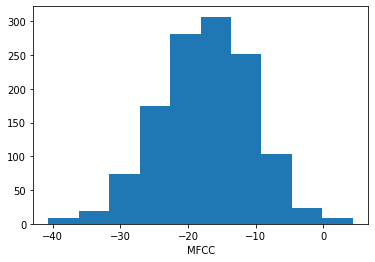

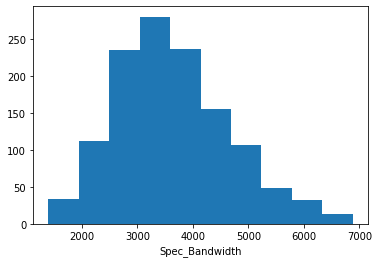

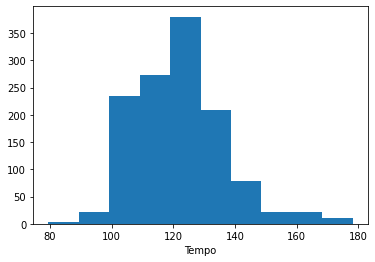

In [ ]:
plt.hist(features_df['MFCC'])
plt.xlabel('MFCC')
plt.show()

plt.hist(features_df['Spec_Bandwidth'])
plt.xlabel('Spec_Bandwidth')
plt.show()

plt.hist(features_df['Tempo'].astype(float))
plt.xlabel('Tempo')
plt.show()

Before scaling the features (X) we will split the dataset into training and validation subsets, then we will fit the scaler on the training set and apply the transform function of both sets to create a normalised version of them. This avoids data leakage as the calculation of the minimum and maximum value for each input variable is calculated using only the training dataset (X_train) instead of the entire dataset (X).'stratify' parameter is set in order to keep the same balance between classes after the splitting.

In [ ]:
scaler = MinMaxScaler()
X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.3, stratify=y)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_val = scaler.transform(X_val)



# 8 Results

**Support Vector Machine model**

Let's build a support vector machine (SVM) model for the predictive task of identifying the song (Potter/StarWars/Panther) of an audio signal, using the dataset that we have just created and the SVM method provided by scikit-learn.


In [ ]:
SVM  = svm.SVC(C=1)
SVM.fit(X_train,y_train)

SVMTrainPrediction = SVM.predict(X_train)
SVMValidationPrediction = SVM.predict(X_val)

print('Training Accuracy', np.mean(SVMTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(SVMValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=SVM.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, SVM.predict(X_val)))

Training Accuracy 0.6335616438356164
Validation  Accuracy 0.5797872340425532
MCC Score 0.3774006725706493
Kappa Score 0.36937529855103235


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=SVM.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=SVM.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[227  44  21]
 [130 132  30]
 [ 66  30 196]]

Validation confusion matrix:
 [[87 25 14]
 [56 45 24]
 [28 11 86]]

Normalised training confusion matrix:
 [[0.77739726 0.15068493 0.07191781]
 [0.44520548 0.45205479 0.10273973]
 [0.2260274  0.10273973 0.67123288]]

Normalised validation confusion matrix:
 [[0.69047619 0.1984127  0.11111111]
 [0.448      0.36       0.192     ]
 [0.224      0.088      0.688     ]]



**Logistic Regression model**

Let's build a Logistic Regression model for the predictive task of identifying the song (Potter/StarWars/Panther) of an audio signal, using the dataset that we have just created and the LogisticRegression method provided by scikit-learn.

In [ ]:
LR = LogisticRegression()
LR.fit(X_train, y_train)

LRTrainPrediction = LR.predict(X_train)
LRValidationPrediction = LR.predict(X_val)

print('Training Accuracy', np.mean(LRTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(LRValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=LR.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, LR.predict(X_val)))

Training Accuracy 0.547945205479452
Validation  Accuracy 0.5186170212765957
MCC Score 0.2814586059620218
Kappa Score 0.27818081540876505


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=LR.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=LR.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[124 103  65]
 [ 76 142  74]
 [ 35  43 214]]

Validation confusion matrix:
 [[45 53 28]
 [32 57 36]
 [15 17 93]]

Normalised training confusion matrix:
 [[0.42465753 0.35273973 0.22260274]
 [0.26027397 0.48630137 0.25342466]
 [0.11986301 0.14726027 0.73287671]]

Normalised validation confusion matrix:
 [[0.35714286 0.42063492 0.22222222]
 [0.256      0.456      0.288     ]
 [0.12       0.136      0.744     ]]



**Naive Bayes model**

Let's build a Gaussian Naive Bayes model for the predictive task of identifying the song (Potter/StarWars/Panther) of an audio signal, using the dataset that we have just created and the GaussianNB method provided by scikit-learn.

In [ ]:
gNB = GaussianNB()
gNB.fit(X_train, y_train)

gNBTrainPrediction = gNB.predict(X_train)
gNBValidationPrediction = gNB.predict(X_val)

print('Training Accuracy', np.mean(gNBTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(gNBValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=gNB.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, gNB.predict(X_val)))

Training Accuracy 0.593607305936073
Validation  Accuracy 0.5904255319148937
MCC Score 0.40072795351011237
Kappa Score 0.38532743118584334


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=gNB.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=gNB.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[212  36  44]
 [130  99  63]
 [ 66  17 209]]

Validation confusion matrix:
 [[93 12 21]
 [54 38 33]
 [26  8 91]]

Normalised training confusion matrix:
 [[0.7260274  0.12328767 0.15068493]
 [0.44520548 0.3390411  0.21575342]
 [0.2260274  0.05821918 0.71575342]]

Normalised validation confusion matrix:
 [[0.73809524 0.0952381  0.16666667]
 [0.432      0.304      0.264     ]
 [0.208      0.064      0.728     ]]



**MLP Classifier**

Let's build a Multi-layer Perceptron classifier model for the predictive task of identifying the song (Potter/StarWars/Panther) of an audio signal, using the dataset that we have just created and the MLPClassifier method provided by sklearn.

In [ ]:
MLP = MLPClassifier(random_state=1, max_iter=1000)
MLP.fit(X_train, y_train)

MLPTrainPrediction = MLP.predict(X_train)
MLPValidationPrediction = MLP.predict(X_val)

print('Training Accuracy', np.mean(MLPTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(MLPValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=MLP.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, MLP.predict(X_val)))

Training Accuracy 0.6198630136986302
Validation  Accuracy 0.601063829787234
MCC Score 0.4079168758425063
Kappa Score 0.4013628547774216


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=MLP.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=MLP.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[214  50  28]
 [122 126  44]
 [ 64  25 203]]

Validation confusion matrix:
 [[87 24 15]
 [51 49 25]
 [24 11 90]]

Normalised training confusion matrix:
 [[0.73287671 0.17123288 0.09589041]
 [0.41780822 0.43150685 0.15068493]
 [0.21917808 0.08561644 0.69520548]]

Normalised validation confusion matrix:
 [[0.69047619 0.19047619 0.11904762]
 [0.408      0.392      0.2       ]
 [0.192      0.088      0.72      ]]



**XGBoost Classifier**

Let's build a AdaBoost Classifier model for the predictive task of identifying the song (Potter/StarWars/Panther) of an audio signal, using the dataset that we have just created and the AdaBoostClassifier method provided by sklearn.

In [ ]:
XGB = XGBClassifier(n_estimators=31, max_depth=2)
XGB.fit(X_train, y_train)

XGBTrainPrediction = XGB.predict(X_train)
XGBValidationPrediction = XGB.predict(X_val)

print('XGBoost results:')
print('\nTraining Accuracy', np.mean(XGBTrainPrediction==y_train))
print('Validation  Accuracy', np.mean(XGBValidationPrediction==y_val))
print('MCC Score', matthews_corrcoef(y_true=y_val, y_pred=XGB.predict(X_val)))
print('Kappa Score', cohen_kappa_score(y_val, XGB.predict(X_val)))

XGBoost results:

Training Accuracy 0.6358447488584474
Validation  Accuracy 0.574468085106383
MCC Score 0.3706453582136616
Kappa Score 0.36135203133791227


In [ ]:
train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=XGB.predict(X_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=XGB.predict(X_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

Training confusion matrix:
 [[242  31  19]
 [142 123  27]
 [ 78  22 192]]

Validation confusion matrix:
 [[92 24 10]
 [58 41 26]
 [27 15 83]]

Normalised training confusion matrix:
 [[0.82876712 0.10616438 0.06506849]
 [0.48630137 0.42123288 0.09246575]
 [0.26712329 0.07534247 0.65753425]]

Normalised validation confusion matrix:
 [[0.73015873 0.19047619 0.07936508]
 [0.464      0.328      0.208     ]
 [0.216      0.12       0.664     ]]



# 9 Conclusions

In [ ]:
print('Model evaluation summary:')

print('\nValidation accuracy:')
print('SVM:', np.mean(SVMValidationPrediction==y_val))
print('Logistic Regression:', np.mean(LRValidationPrediction==y_val))
print('Naive Bayes:', np.mean(gNBValidationPrediction==y_val))
print('MLP:', np.mean(MLPValidationPrediction==y_val))
print('XGBoost:', np.mean(XGBValidationPrediction==y_val))


print('\n--------------------------------------------------------')

print('\nMatthews correlation coefficient:')
print('SVM: '+ str(matthews_corrcoef(y_true=y_val, y_pred=SVM.predict(X_val))))
print('Logistic Regression: '+ str(matthews_corrcoef(y_true=y_val, y_pred=LR.predict(X_val))))
print('Naive Bayes: '+ str(matthews_corrcoef(y_true=y_val, y_pred=gNB.predict(X_val))))
print('MLP: '+ str(matthews_corrcoef(y_true=y_val, y_pred=MLP.predict(X_val))))
print('XGBoost: '+ str(matthews_corrcoef(y_true=y_val, y_pred=XGB.predict(X_val))))


print('\n--------------------------------------------------------')

print('\nKappa Score:')
print('SVM: '+ str(cohen_kappa_score(y_val, SVM.predict(X_val))))
print('Logistic Regression: '+ str(cohen_kappa_score(y_val, LR.predict(X_val))))
print('Naive Bayes: '+ str(cohen_kappa_score(y_val, gNB.predict(X_val))))
print('MLP: '+ str(cohen_kappa_score(y_val, MLP.predict(X_val))))
print('XGBoost: '+ str(cohen_kappa_score(y_val, XGB.predict(X_val))))

Model evaluation summary:

Validation accuracy:
SVM: 0.5797872340425532
Logistic Regression: 0.5186170212765957
Naive Bayes: 0.5904255319148937
MLP: 0.601063829787234
XGBoost: 0.574468085106383

--------------------------------------------------------

Matthews correlation coefficient:
SVM: 0.3774006725706493
Logistic Regression: 0.2814586059620218
Naive Bayes: 0.40072795351011237
MLP: 0.4079168758425063
XGBoost: 0.3706453582136616

--------------------------------------------------------

Kappa Score:
SVM: 0.36937529855103235
Logistic Regression: 0.27818081540876505
Naive Bayes: 0.38532743118584334
MLP: 0.4013628547774216
XGBoost: 0.36135203133791227


As shown in the evaluation report, all the machine learning models trained for this experiment are giving similar results except for Logistic Regression which is the less accurate; although MLP has the best score in all the metrics evaluated having the highest accuracy on validation data, the highest Matthews correlation coefficient and the highest Kappa score.
In order to improve these results different audio features can be extracted and tested in future experiments; classes can be furtherly balanced: even if the amount of Potter, StarWars, Panther samples is balanced, the dataset consists of 303 Panther hums, 294 Potter hums, 304 StarWars hums, 114 Panther whistles, 123 Potter whistles, 113 Starwars whistles, totalling 901 hums and only 350 whistles.